<a href="https://colab.research.google.com/github/TemaG33/ML_object_detection/blob/main/tensorflow_object__detection_ap.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


# TensorFlow Object Detection: подготовка данных для обучения

### Монтирование Google Drive
Для демо нам понадобятся несколько ноутбуков, которые должны работать с одними и теми же данными. Поэтому, чтобы все ноутбуки имели доступ к нужным данным, необходимо подключить диск Google Drive и сохранять все данные на нём (включая данные, скачанные из интернета).

Для монтирования диска выполните этот блок, перейдите по ссылке, получите код, скопируйте его в поле ниже (в этом блоке) и нажмите Enter.

После монтирования диск будет находиться здесь: `/content/drive/MyDrive`

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!ls /content/drive

MyDrive


### Рабочая директория
Все данные будем хранить в директории `/content/drive/My Drive/tf_od_demo` (TensorFlow Object Detection Demo).

При первом запуске создайте директорию (если её ещё не существует), в противном случае замените True на False.

При последующих подключениях к диску (в том числе в других ноутбуках) директорию создавать не надо, в ней уже будут сохранены все данные, которые вы туда поместили.

In [ ]:

!mkdir "/content/drive/My Drive/t_od_demo"
%cd "/content/drive/My Drive/t_od_demo"

mkdir: cannot create directory ‘/content/drive/My Drive/t_od_demo’: File exists
/content/drive/My Drive/t_od_demo


## 1. Установка всех необходимых библиотек

Подробнее: https://github.com/tensorflow/models/tree/master/research/object_detection

In [ ]:
#install tfslim
!pip install tf_slim
#nstall pycocotools
!pip install pycocotools

In [ ]:
import tensorflow as tf

In [ ]:
import tensorflow as tf
tf.version.VERSION

'2.12.0'

**Клонируйте репозиторий официальных моделей**

In [ ]:
! pip install tf-models-official

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.6/2.6 MB 28.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 175.1/175.1 kB 13.1 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 118.9/118.9 kB 15.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 48.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.6/43.6 kB 5.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 241.2/241.2 kB 25.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.5/6.5 MB 105.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 524.1/524.1 MB 3.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 90.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.6/5.6 MB 112.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━

In [ ]:
import os
import pathlib

In [ ]:

if  "models"  in pathlib.Path.cwd().parts:
   while  "models"  in pathlib.Path.cwd().parts:
    os.chdir('..')
elif  not pathlib.Path('models').exists():
	!git clone --depth 1 https://github.com/tensorflow/models

**Преобразование файлов PROTO в файлы Python**

In [ ]:
!pwd

/content/drive/MyDrive/t_od_demo


In [ ]:
%%bash
cd models/research/
protoc object_detection/protos/*.proto --python_out=.

In [ ]:
!ls

exported-models  models  my_data  ssd_mobilenet_v2_320x320_coco17_tpu-8


**Установка библиотеки обнаружения объектов**

In [ ]:
!pip install tensorflow-object-detection-api

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 577.4/577.4 kB 11.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.9/121.9 kB 13.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 6.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 48.4/48.4 kB 6.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 84.9/84.9 kB 11.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 42.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.3/4.3 MB 75.0 MB/s eta 0:00:00
  Created wheel for tensorflow-object-detection-api: filename=tensorflow_object_detection_api-0.1.1-py3-none-any.whl size=844490 sha256=9d6be540e608237815b8c6a710ad6858f9a36dbe05cb3b572291dcaeb20e8e5b
  Stored in directory: /root/.cache/pip/wheels/8a/55/68/c084bc2cd93c41fd8f7e2ef9e6bbcb2c35a3e4b49e42044d02
Successfully built tensorflow-object-detection-api


**Импорт всех необходимых пакетов**

In [ ]:
#Import the necessary packages
import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile
from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image
from IPython.display import display

#Import the object detection modules
from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

**Настройка некоторых исправлений для TF2 из TF1**

In [ ]:
#patch tf1 into `utils.ops`
utils_ops.tf = tf.compat.v1
#Patch the location of gfile
tf.gfile = tf.io.gfile

**Загрузчик моделей и функция загрузки**

In [ ]:
def  load_model(model_name):
	base_url =  'http://download.tensorflow.org/models/object_detection/tf2/20200711/'
	model_file = model_name +  '.tar.gz'
	model_dir = tf.keras.utils.get_file(
	fname=model_name,
	origin=base_url + model_file,
	untar=True)
	model_dir = pathlib.Path(model_dir)/"saved_model"
	model = tf.saved_model.load(str(model_dir))
	return model

**Загрузка карты меток**

In [ ]:
PATH_TO_LABELS =  'models/research/object_detection/data/mscoco_label_map.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)

**Переходим к части обнаружения**

In [ ]:
import pathlib

In [ ]:
PATH_TO_TEST_IMAGES_DIR = pathlib.Path('models/research/object_detection/test_images')
TEST_IMAGE_PATHS =  sorted(list(PATH_TO_TEST_IMAGES_DIR.glob("*.jpg")))
TEST_IMAGE_PATHS

[PosixPath('models/research/object_detection/test_images/image1.jpg'),
 PosixPath('models/research/object_detection/test_images/image2.jpg'),
 PosixPath('models/research/object_detection/test_images/image3.jpg')]

**Выбор модели из Model Zoo**

In [ ]:
model_name =  "ssd_mobilenet_v2_320x320_coco17_tpu-8" #ssd_mobilenet_v2_320x320_coco17_tpu-8  ssd_mobilenet_v2
detection_model = load_model(model_name)

46042990/46042990 [==============================] - 0s 0us/step


**Проверка подписи моделей, то есть выходных форм, типов данных и входных данных**

In [ ]:
print(detection_model.signatures['serving_default'].inputs)
detection_model.signatures['serving_default'].output_dtypes
detection_model.signatures['serving_default'].output_shapes

[<tf.Tensor 'input_tensor:0' shape=(1, None, None, 3) dtype=uint8>, <tf.Tensor 'unknown:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_0:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_1:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_2:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_3:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_4:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_5:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_6:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_7:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_8:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_9:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_10:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_11:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_12:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_13:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_14:0' shape=<unknown> dtype=resource>, <

{'raw_detection_scores': TensorShape([1, 1917, 91]),
 'raw_detection_boxes': TensorShape([1, 1917, 4]),
 'detection_boxes': TensorShape([1, 100, 4]),
 'detection_classes': TensorShape([1, 100]),
 'detection_multiclass_scores': TensorShape([1, 100, 91]),
 'detection_scores': TensorShape([1, 100]),
 'num_detections': TensorShape([1]),
 'detection_anchor_indices': TensorShape([1, 100])}

**Использование функции для загрузки и выполнения прогнозирования**

In [ ]:
def run_inference_for_single_image(model, image):
  image = np.asarray(image)
  # Входные данные должны быть тензором, преобразуйте их с помощью `tf.convert_to_tensor`.
  input_tensor = tf.convert_to_tensor(image)
  # Модель ожидает пакет изображений, поэтому добавьте ось с помощью `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis,...]

  # Выполнить вывод
  model_fn = model.signatures['serving_default']
  output_dict = model_fn(input_tensor)

  # Все выходные данные являются пакетами тензоров.
  # Преобразуйте в массивы numpy и возьмите индекс [0], чтобы удалить пакетное измерение.
  # Нас интересуют только первые num_detections.
  num_detections = int(output_dict.pop('num_detections'))
  output_dict = {key:value[0, :num_detections].numpy()
                 for key,value in output_dict.items()}
  output_dict['num_detections'] = num_detections

  # detection_classes должны быть целые.
  output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)

  # Обрабатывайте модели с масками:
  if 'detection_masks' in output_dict:
    # Измените рамку маски поля в соответствии с размером изображения.
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              output_dict['detection_masks'], output_dict['detection_boxes'],
               image.shape[0], image.shape[1])
    detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                       tf.uint8)
    output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()

  return output_dict

**Запуск модуля обнаружения объектов с некоторыми тестовыми изображениями**

В папке обнаружения объектов есть папка под названием «Тестовые изображения» с несколькими изображениями.

In [ ]:
def show_inference(model, image_path):
  # представление изображения на основе массива будет использовано позже для подготовки
  # конечного изображения с боксами и надписями на нем.
  image_np = np.array(Image.open(image_path))
  # Фактическое обнаружение.
  output_dict = run_inference_for_single_image(model, image_np)
  # Визуализация результатов обнаружения.
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=8)

  display(Image.fromarray(image_np))

**Отображение окончательных результатов**

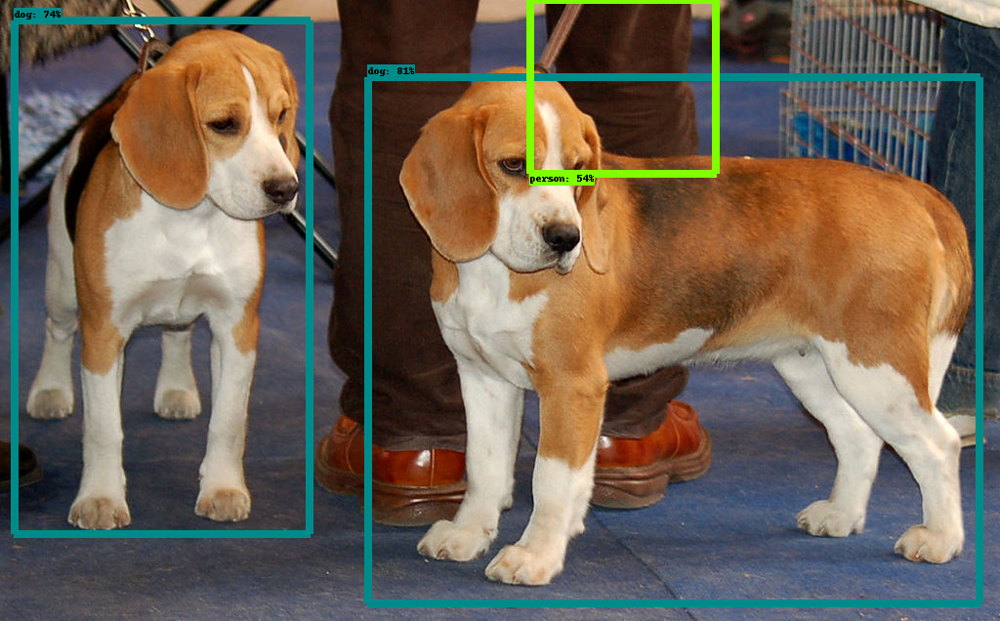

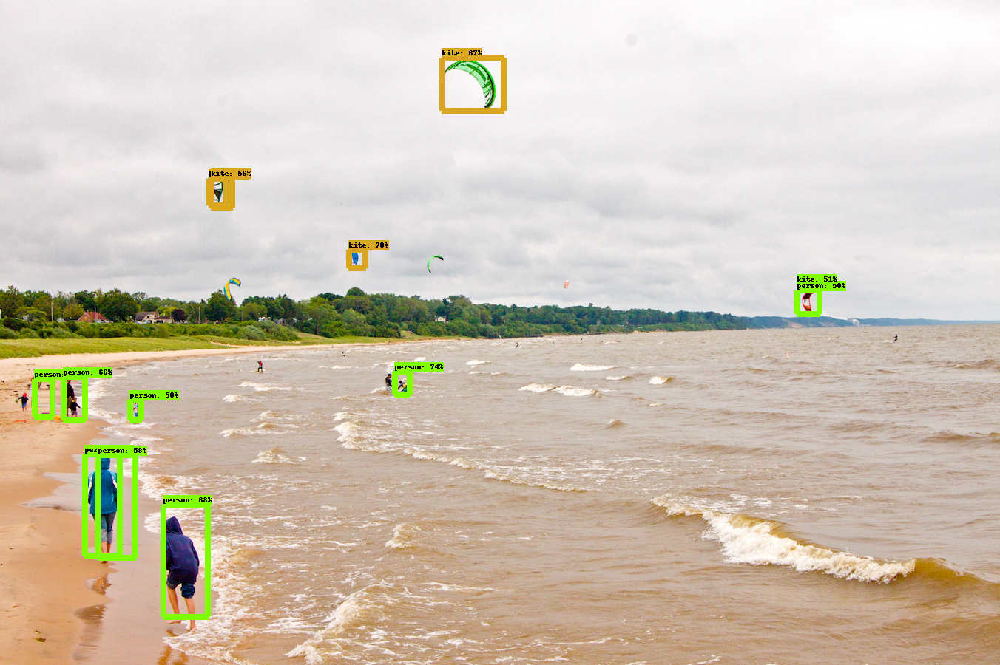

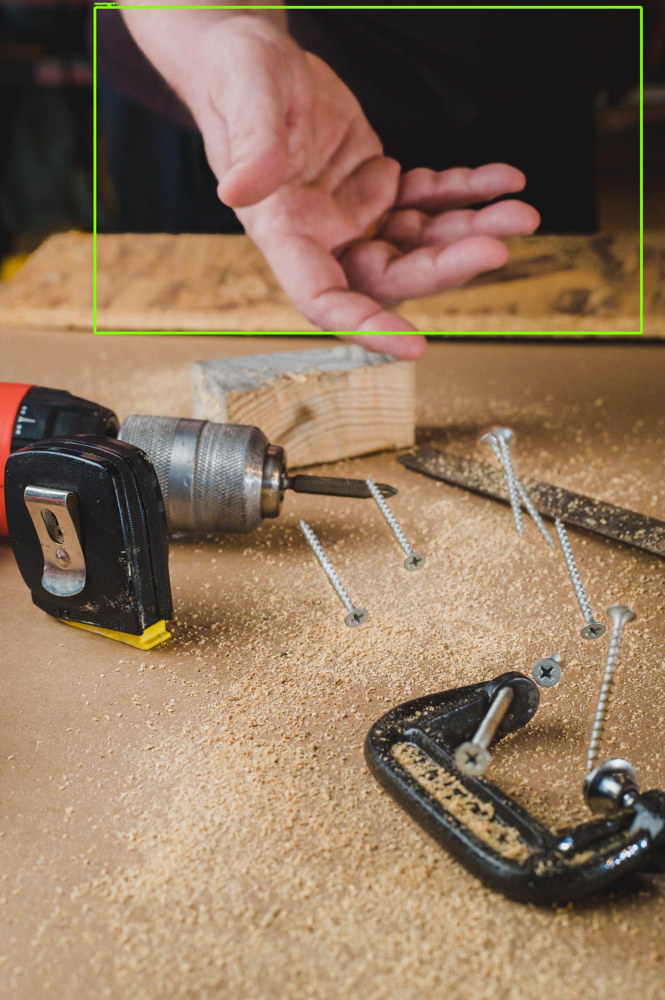

In [ ]:
for image_path in TEST_IMAGE_PATHS:
  show_inference(detection_model, image_path)

Если появились изображения с детекцией объектов — значит, всё установилось отлично!


##2. Подготовка набора данных для пользовательского обучения

**Подключение Google Диска к Colab**

**Создание Labelmap.pbtxt**

In [ ]:
PATH_TO_LABELS =  'my_data/ship_label_map.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)

**Создание TFRecord**

In [ ]:
#Import the necessary packages
import pandas as pd

In [ ]:
annot = pd.read_csv('my_data/annot.csv')
annot.head()

,id,xmin,ymin,xmax,ymax
0,1.jpg,310,543,720,853
1,2.jpg,223,292,603,732
2,3.jpg,318,676,604,1133
3,4.jpg,181,927,595,1147
4,5.jpg,298,232,768,753


Здесь мы создаём финальный датасет в формате `TFRecord`, который необходим для запуска обучения TF Object Detection.

В цикле по всем обучающим образцам создаём `TF Example` и записываем его в `TF Record`.

In [ ]:
from object_detection.utils import dataset_util

In [ ]:
def create_tf_example(example):

    img_fpath = os.path.join('my_data', example.id)
    img = Image.open(img_fpath)
    height = img.size[1]
    width = img.size[0]
    filename = str.encode(example.id)
    with open(img_fpath, mode='rb') as f:
        encoded_image_data = f.read()
    image_format = b'jpeg'

    # List of normalized left x coordinates in bounding box (1 per box)
    xmins = [example.xmin / float(width)]
    # List of normalized right x coordinates in bounding box # (1 per box)
    xmaxs = [example.xmax / float(width)]
    # List of normalized top y coordinates in bounding box (1 per box)
    ymins = [example.ymin / float(height)]
    # List of normalized bottom y coordinates in bounding box # (1 per box)
    ymaxs = [example.ymax / float(height)]
    # List of string class name of bounding box (1 per box)
    classes_text = [b'ship']
    # List of integer class id of bounding box (1 per box)
    classes = [1]

    tf_example = tf.train.Example(features=tf.train.Features(feature={
        'image/height': dataset_util.int64_feature(height),
        'image/width': dataset_util.int64_feature(width),
        'image/filename': dataset_util.bytes_feature(filename),
        'image/source_id': dataset_util.bytes_feature(filename),
        'image/encoded': dataset_util.bytes_feature(encoded_image_data),
        'image/format': dataset_util.bytes_feature(image_format),
        'image/object/bbox/xmin': dataset_util.float_list_feature(xmins),
        'image/object/bbox/xmax': dataset_util.float_list_feature(xmaxs),
        'image/object/bbox/ymin': dataset_util.float_list_feature(ymins),
        'image/object/bbox/ymax': dataset_util.float_list_feature(ymaxs),
        'image/object/class/text': dataset_util.bytes_list_feature(classes_text),
        'image/object/class/label': dataset_util.int64_list_feature(classes),
    }))
    return tf_example

In [ ]:
writer = tf.io.TFRecordWriter('my_data/train_data.record')

for idx, row in annot.iterrows():
    tf_example = create_tf_example(row)
    writer.write(tf_example.SerializeToString())

writer.close()

**Получаем конфигурационный файл и вносим необходимые изменения**

**Начнём обучение**

In [ ]:
!pip install lvis

In [ ]:
!pip install tensorflow_io

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 28.0/28.0 MB 29.3 MB/s eta 0:00:00


In [ ]:
!export PYTHONPATH=$PYTHONPATH:`pwd`:`pwd`/slim

In [ ]:
training_demo/
├─ ...
├─ pre-trained-models/
|  └─ ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/
|     ├─ checkpoint/
│     ├─ saved_model/
|     └─ pipeline.config

In [ ]:




!export PYTHONPATH=$PYTHONPATH:models/research:models/research/slim ; python models/research/object_detection/model_main_tf2.py \
--model_dir=my_data/output\
--pipeline_config_path=my_data/pipeline.config

2023-07-05 20:16:59.555975: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
/usr/local/lib/python3.10/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(
2023-07-05 20:17:03.405621: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:47] Overriding orig_value setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
I0705 20:17:03.427115 139658732648256 mir

In [ ]:
%%time

if False:
      # Delete output directory
      !rm my_data/output

!export PYTHONPATH=$PYTHONPATH:models/research:models/research/slim ; python models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path=my_data/pipeline.config \
    --model_dir=my_data/output \
    --num_train_steps=30000 \
    --alsologtostderr

2023-07-09 13:10:16.806319: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/__init__.py:98: UserWarning: unable to load libtensorflow_io_plugins.so: unable to open file: libtensorflow_io_plugins.so, from paths: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so']
caused by: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so: undefined symbol: _ZN3tsl6Status12empty_stringB5cxx11Ev']
  warnings.warn(f"unable to load libtensorflow_io_plugins.so: {e}")
/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/__init__.py:104: UserWarning: file system plugins are not loaded: unable to open file: libtensorflow_io.so, from paths: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io.so']
caused by: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/pytho

In [ ]:
tf.python.framework.errors_impl

AttributeError: ignored

**Оценка модели**

In [ ]:

!export PYTHONPATH=$PYTHONPATH:models/research:models/research/slim ; python models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path=my_data/pipeline.config \
    --model_dir=my_data/output \
    --max_number_of_evaluations=1 \
    --checkpoint_dir=.ipynb_checkpoints #my_data/output

2023-07-09 13:44:00.185122: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/__init__.py:98: UserWarning: unable to load libtensorflow_io_plugins.so: unable to open file: libtensorflow_io_plugins.so, from paths: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so']
caused by: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so: undefined symbol: _ZN3tsl6Status12empty_stringB5cxx11Ev']
  warnings.warn(f"unable to load libtensorflow_io_plugins.so: {e}")
/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/__init__.py:104: UserWarning: file system plugins are not loaded: unable to open file: libtensorflow_io.so, from paths: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io.so']
caused by: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/pytho

**Экспорт графика**

In [ ]:
!export PYTHONPATH=$PYTHONPATH:models/research:models/research/slim ; python models/research/object_detection/exporter_main_v2.py \
      --input_type image_tensor \
      --pipeline_config_path my_data/pipeline.config \
      --trained_checkpoint_dir my_data/output \
      --output_directory exported-models/my_model

2023-07-09 13:44:13.189719: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/__init__.py:98: UserWarning: unable to load libtensorflow_io_plugins.so: unable to open file: libtensorflow_io_plugins.so, from paths: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so']
caused by: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so: undefined symbol: _ZN3tsl6Status12empty_stringB5cxx11Ev']
  warnings.warn(f"unable to load libtensorflow_io_plugins.so: {e}")
/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/__init__.py:104: UserWarning: file system plugins are not loaded: unable to open file: libtensorflow_io.so, from paths: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io.so']
caused by: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/pytho

**Выполнение прогнозирования на основе пользовательской обученной модели**

In [ ]:
def load_custom_model(model_name):
  model_file = model_name
  model_dir = pathlib.Path(model_file)/"saved_model"
  model = tf.saved_model.load(str(model_dir))
  return model

In [ ]:
PATH_TO_LABELS = 'my_data/ship_label_map.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)

In [ ]:
import pathlib
PATH_TO_TEST_IMAGES_DIR = pathlib.Path('my_data')
TEST_IMAGE_PATHS =  sorted(list(PATH_TO_TEST_IMAGES_DIR.glob("*.jpg")))
TEST_IMAGE_PATHS

[PosixPath('my_data/1.jpg'),
 PosixPath('my_data/10.jpg'),
 PosixPath('my_data/2.jpg'),
 PosixPath('my_data/3.jpg'),
 PosixPath('my_data/4.jpg'),
 PosixPath('my_data/5.jpg'),
 PosixPath('my_data/6.jpg'),
 PosixPath('my_data/7.jpg'),
 PosixPath('my_data/8.jpg'),
 PosixPath('my_data/9.jpg'),
 PosixPath('my_data/test.jpg'),
 PosixPath('my_data/test1.jpg'),
 PosixPath('my_data/test2.jpg')]

In [ ]:
model_name =  "exported-models/my_model"
detection_model = load_custom_model(model_name)

In [ ]:
print(detection_model.signatures['serving_default'].inputs)
detection_model.signatures['serving_default'].output_dtypes
detection_model.signatures['serving_default'].output_shapes

[<tf.Tensor 'input_tensor:0' shape=(1, None, None, 3) dtype=uint8>, <tf.Tensor 'unknown:0' shape=() dtype=resource>, <tf.Tensor 'unknown_0:0' shape=() dtype=resource>, <tf.Tensor 'unknown_1:0' shape=() dtype=resource>, <tf.Tensor 'unknown_2:0' shape=() dtype=resource>, <tf.Tensor 'unknown_3:0' shape=() dtype=resource>, <tf.Tensor 'unknown_4:0' shape=() dtype=resource>, <tf.Tensor 'unknown_5:0' shape=() dtype=resource>, <tf.Tensor 'unknown_6:0' shape=() dtype=resource>, <tf.Tensor 'unknown_7:0' shape=() dtype=resource>, <tf.Tensor 'unknown_8:0' shape=() dtype=resource>, <tf.Tensor 'unknown_9:0' shape=() dtype=resource>, <tf.Tensor 'unknown_10:0' shape=() dtype=resource>, <tf.Tensor 'unknown_11:0' shape=() dtype=resource>, <tf.Tensor 'unknown_12:0' shape=() dtype=resource>, <tf.Tensor 'unknown_13:0' shape=() dtype=resource>, <tf.Tensor 'unknown_14:0' shape=() dtype=resource>, <tf.Tensor 'unknown_15:0' shape=() dtype=resource>, <tf.Tensor 'unknown_16:0' shape=() dtype=resource>, <tf.Tenso

{'detection_classes': TensorShape([1, 100]),
 'raw_detection_scores': TensorShape([1, 1917, 2]),
 'raw_detection_boxes': TensorShape([1, 1917, 4]),
 'detection_boxes': TensorShape([1, 100, 4]),
 'detection_multiclass_scores': TensorShape([1, 100, 2]),
 'detection_anchor_indices': TensorShape([1, 100]),
 'detection_scores': TensorShape([1, 100]),
 'num_detections': TensorShape([1])}

In [ ]:
def run_inference_for_single_image(model, image):
  image = np.asarray(image)
  # Входные данные должны быть тензором, преобразуйте их с помощью `tf.convert_to_tensor`.
  input_tensor = tf.convert_to_tensor(image)
  # Модель ожидает пакет изображений, поэтому добавьте ось с помощью `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis,...]

  # Выполнить вывод
  model_fn = model.signatures['serving_default']
  output_dict = model_fn(input_tensor)

  # Все выходные данные являются пакетами тензоров.
  # Преобразуйте в массивы numpy и возьмите индекс [0], чтобы удалить пакетное измерение.
  # Нас интересуют только первые num_detections.
  num_detections = int(output_dict.pop('num_detections'))
  output_dict = {key:value[0, :num_detections].numpy()
                 for key,value in output_dict.items()}
  output_dict['num_detections'] = num_detections

  # detection_classes должны быть целые.
  output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)

  # Обрабатывайте модели с масками:
  if 'detection_masks' in output_dict:
    # Измените рамку маски поля в соответствии с размером изображения.
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              output_dict['detection_masks'], output_dict['detection_boxes'],
               image.shape[0], image.shape[1])
    detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                       tf.uint8)
    output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()

  return output_dict

In [ ]:
def show_inference(model, image_path):
  # представление изображения на основе массива будет использовано позже для подготовки
  # конечного изображения с боксами и надписями на нем.
  image_np = np.array(Image.open(image_path))
  # Фактическое обнаружение.
  output_dict = run_inference_for_single_image(model, image_np)
  # Визуализация результатов обнаружения.
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=8)

  display(Image.fromarray(image_np))

In [ ]:
from keras.utils import image_dataset

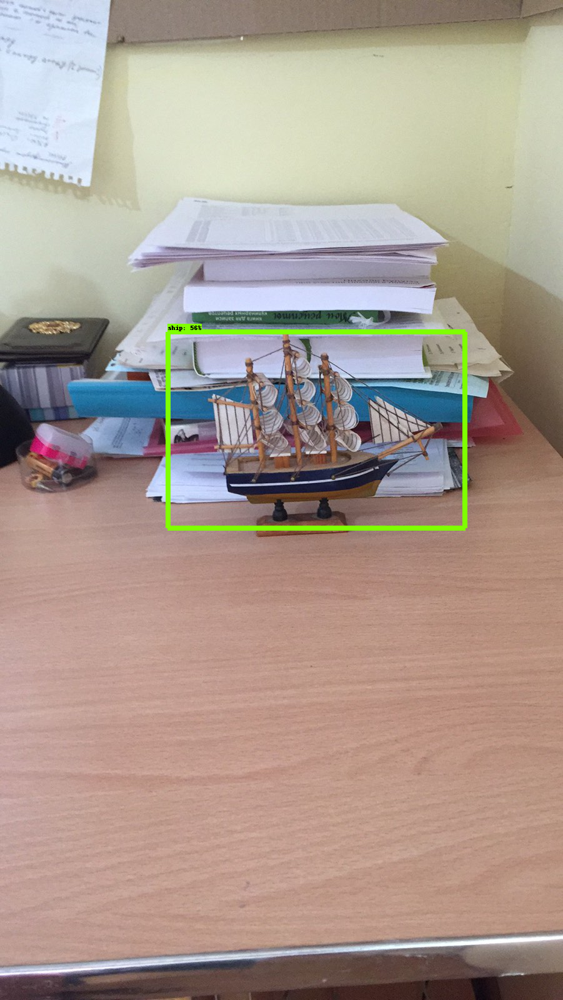

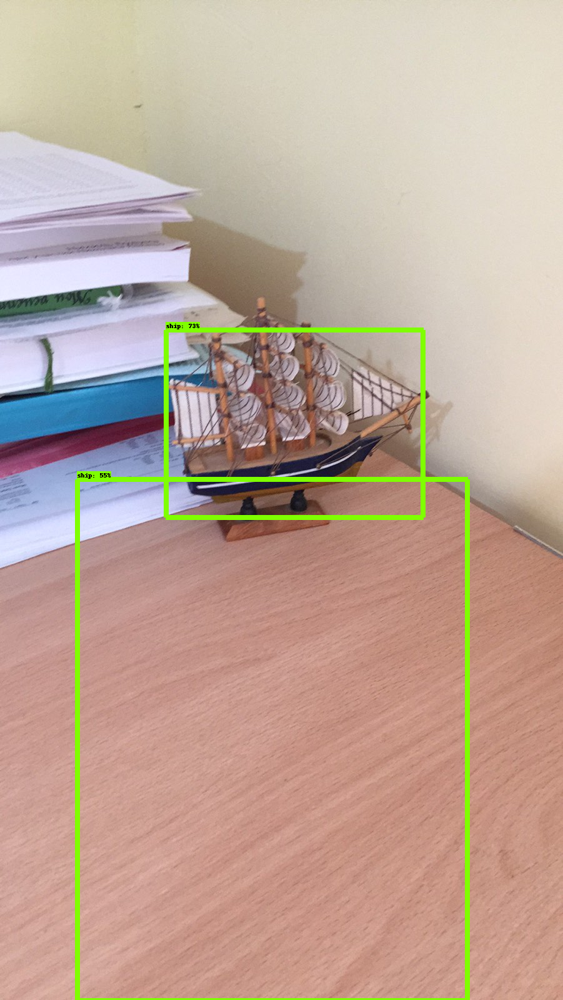

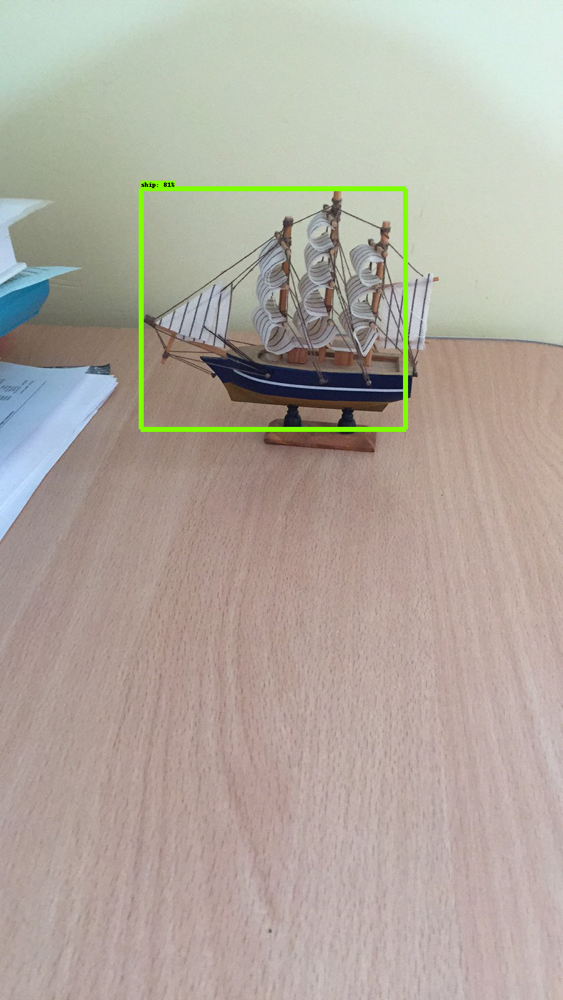

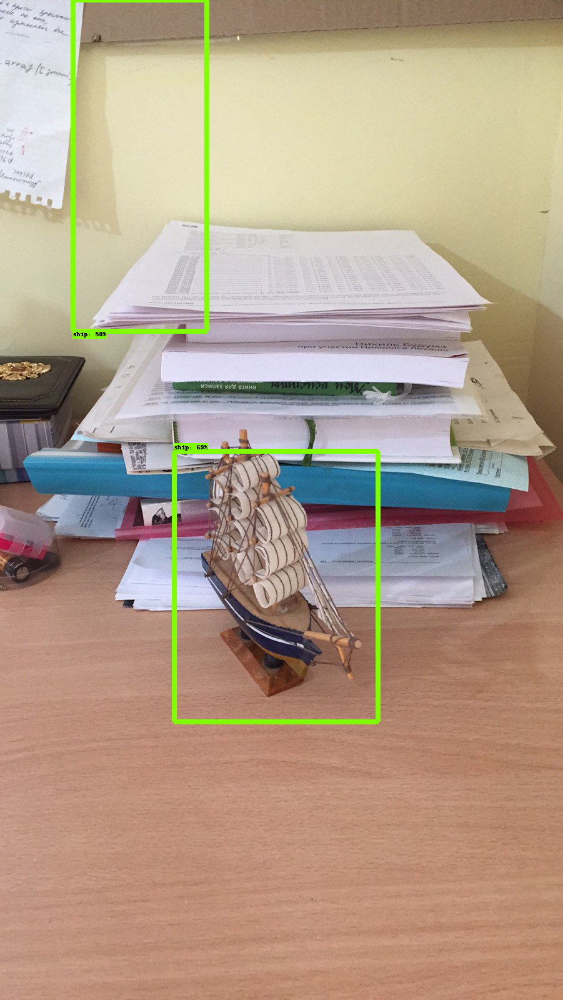

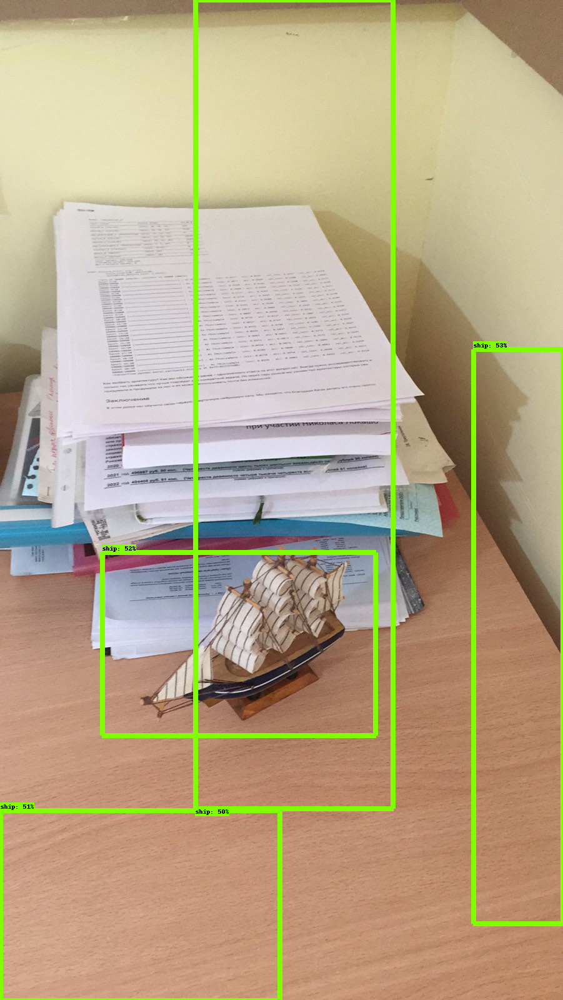

...

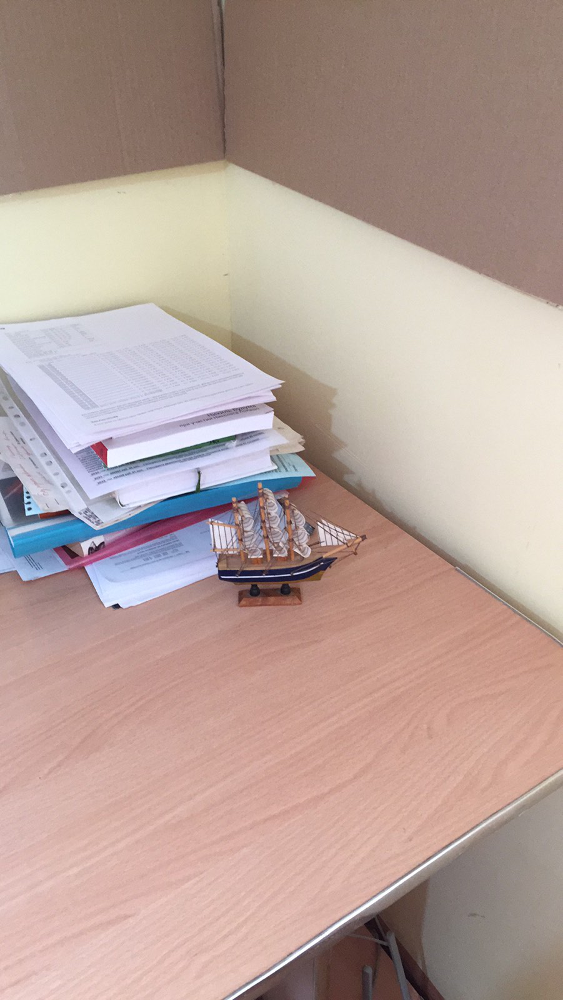

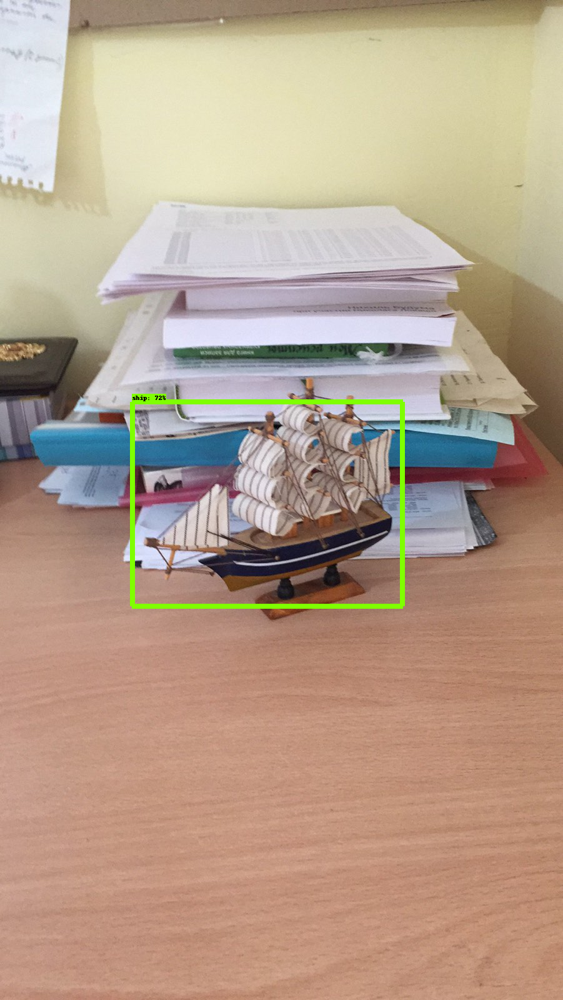

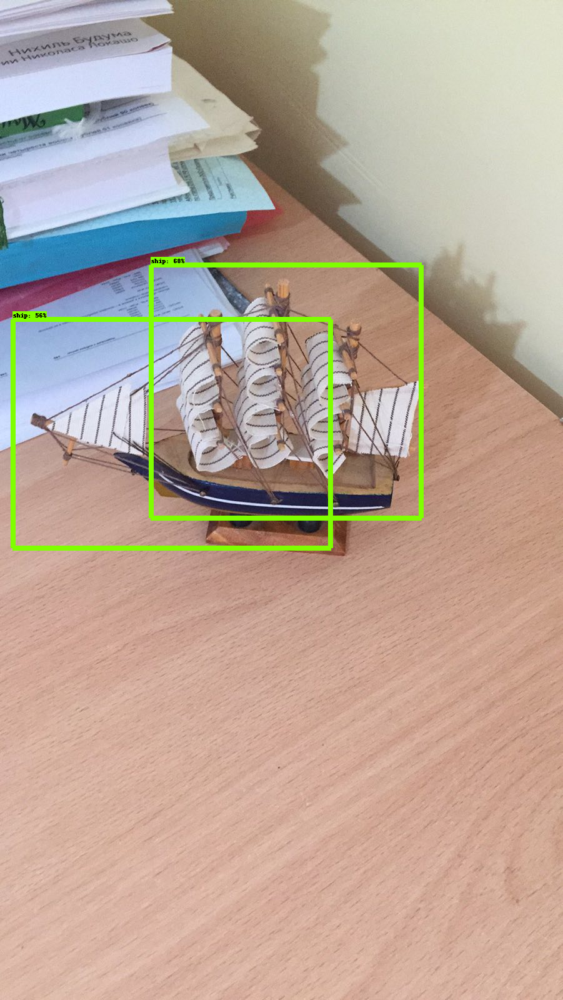

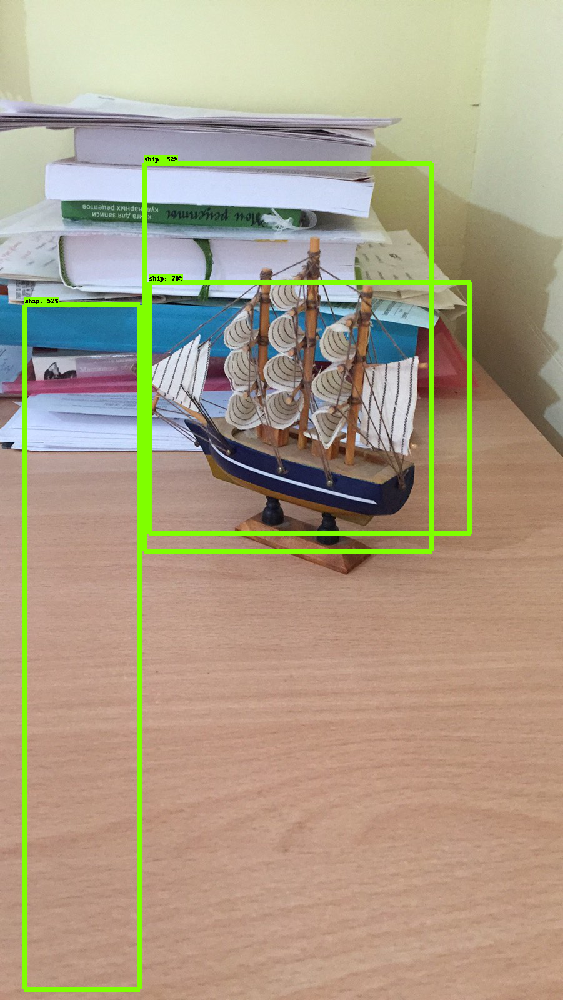

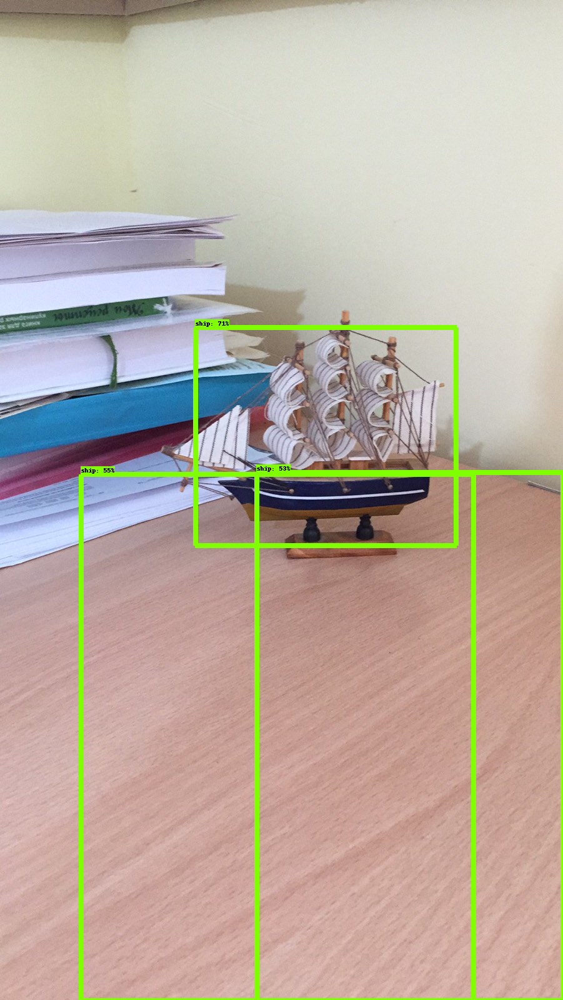

In [ ]:
for image_path in TEST_IMAGE_PATHS:
  show_inference(detection_model, image_path)

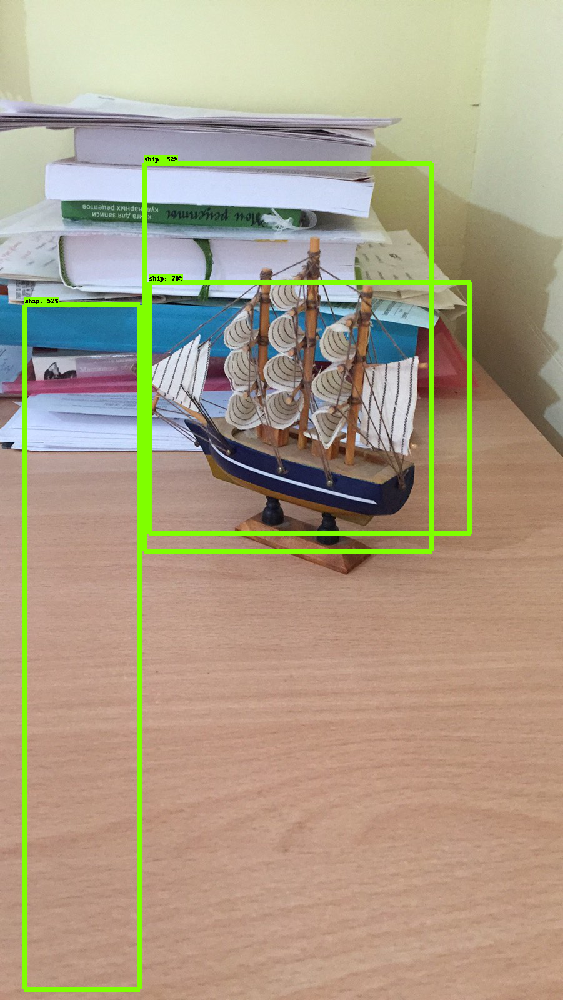

In [ ]:
TEST_IMAGE_PATH = pathlib.Path('my_data/test1.jpg')

show_inference(detection_model, TEST_IMAGE_PATH)